In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import random

## 1. Generate Data

In [2]:
def boundary(slope, x):
    return slope*(x**2) + x

def generate_datapoints(slope, lower=0, upper=100, n_datapoints=600, class_1_ratio = 0.5,):

    random.seed(100)
    np.random.seed(100)

    X = np.zeros((n_datapoints, 2))
    labels = np.zeros(n_datapoints)

    n_class_1 = int(n_datapoints * class_1_ratio)
    n_class_0 = n_datapoints - n_class_1  
    counter_c1 = 0
    counter_c0 = 0

    for i in range(n_datapoints):
        while True:
            x1_i = random.uniform(lower, upper)
            x2_i = random.uniform(lower, upper)
            y_boundary = boundary(slope, x1_i)

            if x2_i > y_boundary and counter_c1 < n_class_1:
                labels[i] = 1
                counter_c1 += 1
            elif x2_i < y_boundary and counter_c0 < n_class_0:
                labels[i] = 0
                counter_c0 += 1
            else:
                continue

            X[i][0] = x1_i
            X[i][1] = x2_i

            break

    return X, labels

    

In [3]:
low = -30
up = 50 

## 2. Logistic Regression

Build a logistic regression model

In [4]:
from sklearn.model_selection import train_test_split 
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score,precision_score, recall_score

In [5]:
def plot_boundary(X, y, model, title, ax=None, show_colorbar=False):
    if ax is None:
        f, ax = plt.subplots(figsize=(8, 6))

    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1

    xx, yy = np.mgrid[x_min:x_max:0.05, y_min:y_max:0.05]
    grid = np.c_[xx.ravel(), yy.ravel()]
    probs = model.predict_proba(grid)[:, 1].reshape(xx.shape)

    contour = ax.contourf(xx, yy, probs, 25, cmap="RdBu", vmin=0, vmax=1)
    
    if show_colorbar:
        ax_c = plt.colorbar(contour, ax=ax)
        ax_c.set_label("$P(y = 1)$")

    ax.scatter(X[:,0], X[:, 1], c=y, cmap="RdBu", edgecolor="white", s=30 )
    ax.set_title(title, fontsize=10)

### 2.2 Performance of Logistic Regression model for various value of a (slope)

Initialize different values for `a` and plot the data distribution

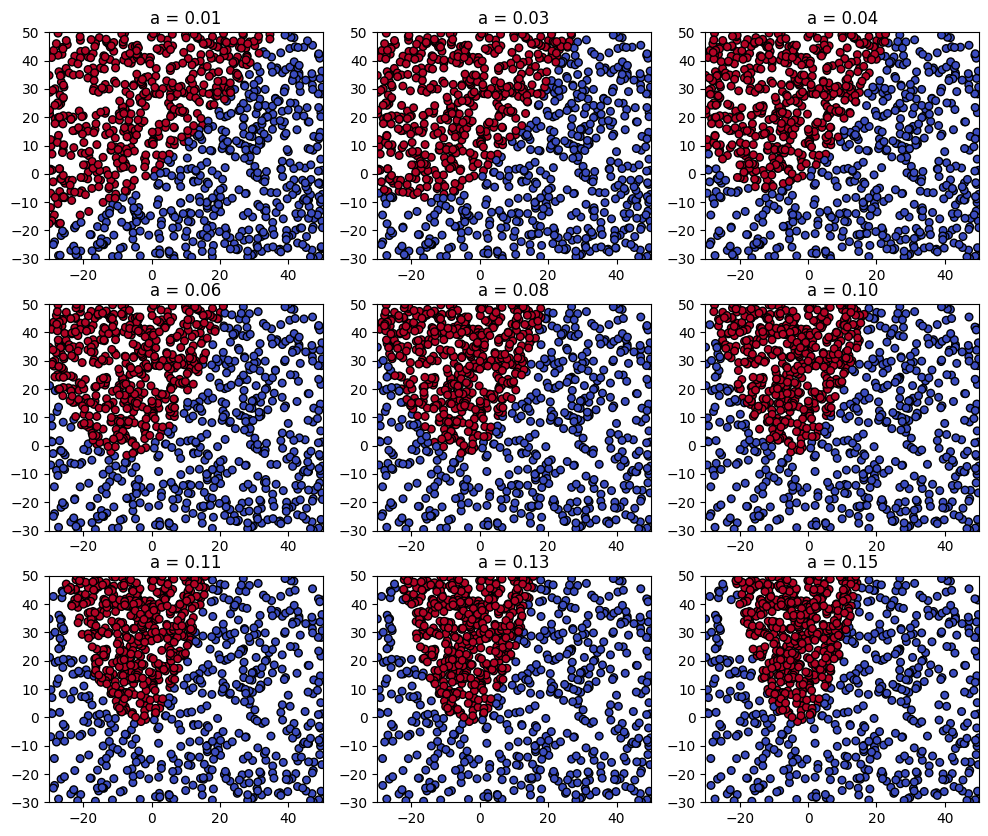

In [6]:
a_value = np.linspace(0.01, 0.15, 9)

fig, axes = plt.subplots(3, 3, figsize=(12, 10))
for ax, a in zip(axes.ravel(), a_value):
    X, y = generate_datapoints(slope=a, lower=low, upper=up,
                                n_datapoints=1000, class_1_ratio=0.5)
    ax.scatter(X[:, 0], X[:, 1], c=y, cmap='coolwarm', s=30, edgecolors='k')
    ax.set_title(f"a = {a:.2f}")
    ax.set_xlim(low, up)
    ax.set_ylim(low, up)

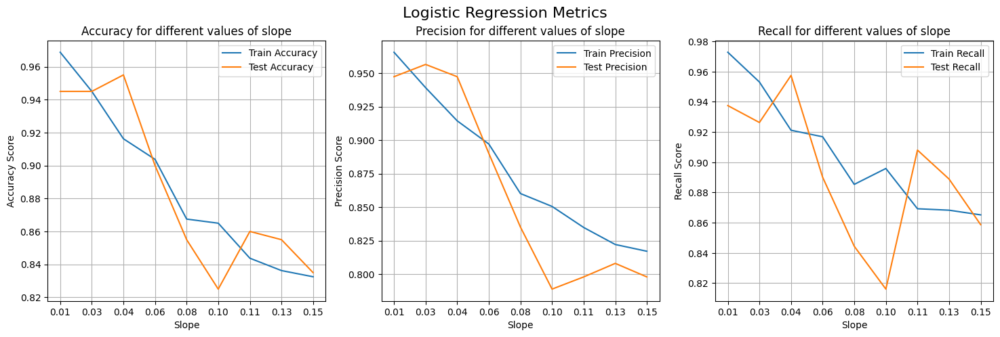

In [7]:
random.seed(100)
np.random.seed(100)

train_acc = []
test_acc = []

train_precision = []
train_recall = []
test_precision = []
test_recall = []
contour = []
c_matrix = []

for a in a_value:

    X, y = generate_datapoints(slope= a, lower=low, upper=up,
                                       n_datapoints=1000, class_1_ratio=0.5)
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=100)

    model = LogisticRegression()
    model.fit(X_train, y_train)
    train_pred = model.predict(X_train)
    y_pred = model.predict(X_test)

    contour.append((X, y, model))
    c_matrix.append(confusion_matrix(y_test, y_pred))

    train_accuracy = accuracy_score(y_train, train_pred)
    test_accuracy = accuracy_score(y_test, y_pred)

    train_acc.append(train_accuracy)
    test_acc.append(test_accuracy)

    train_precision.append(precision_score(y_train, train_pred))
    train_recall.append(recall_score(y_train, train_pred))

    test_precision.append(precision_score(y_test, y_pred))
    test_recall.append(recall_score(y_test, y_pred))
    
fig, axs = plt.subplots(1, 3, figsize=(18, 5))
fig.suptitle("Logistic Regression Metrics", fontsize=16)

metrics = [
    ("Accuracy", train_acc, test_acc),
    ("Precision", train_precision, test_precision),
    ("Recall", train_recall, test_recall)
]

for i, (title, train_vals, test_vals) in enumerate(metrics):
    axs[i].plot(a_value, train_vals, label=f'Train {title}')
    axs[i].plot(a_value, test_vals, label=f'Test {title}')
    
    axs[i].set_title(f"{title} for different values of slope")
    axs[i].set_xlabel("Slope")
    axs[i].set_ylabel(f"{title} Score")
    axs[i].set_xticks(a_value)
    axs[i].set_xticklabels([f"{a:.2f}" for a in a_value])
    axs[i].grid(True)
    axs[i].legend()

plt.show()

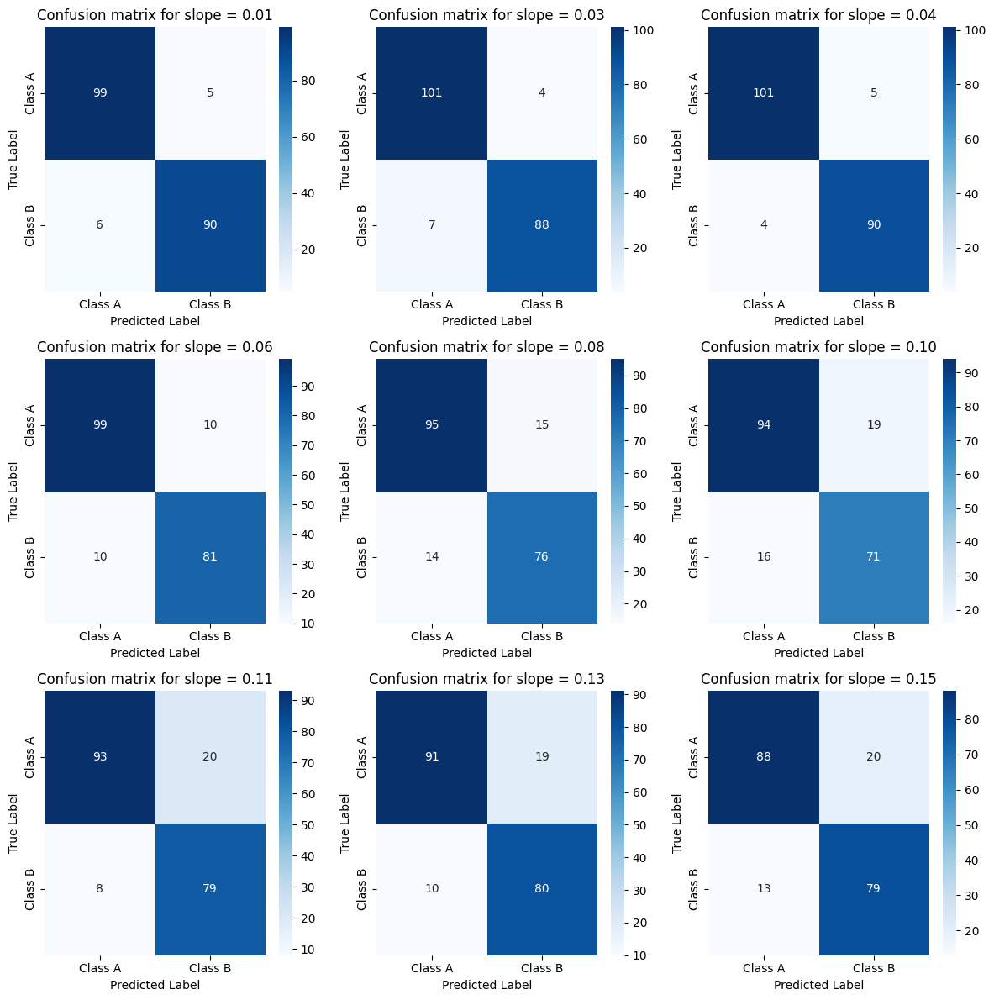

In [8]:
fig, axes = plt.subplots(3,3, figsize=(12,12) )

for ax, i in zip(axes.ravel(), range(len(c_matrix))):
    sns.heatmap(data=c_matrix[i], annot=True,fmt='d', cmap='Blues',
            xticklabels=['Class A', 'Class B'], yticklabels=['Class A', 'Class B'], ax=ax)
    ax.set_xlabel("Predicted Label")
    ax.set_ylabel("True Label")
    ax.set_title(f'Confusion matrix for slope = {a_value[i]:.2f}')
plt.tight_layout()
plt.show()

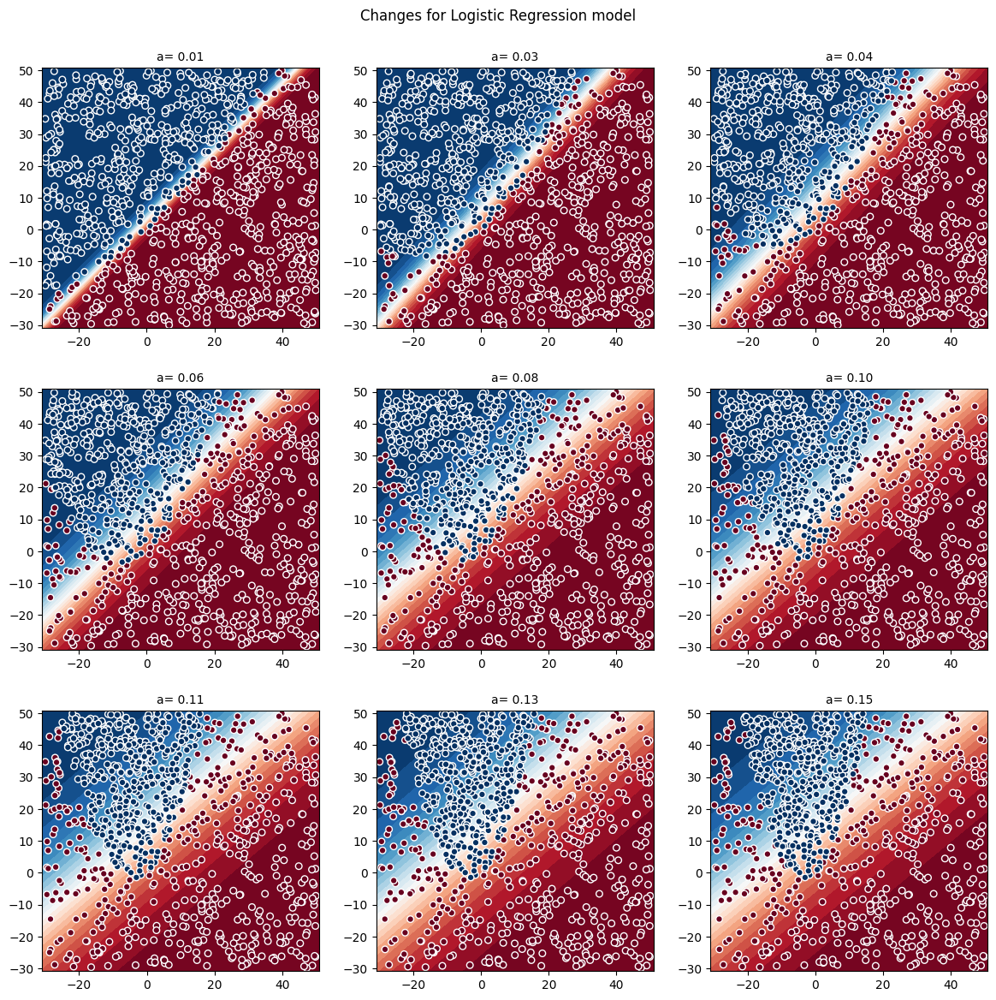

In [9]:
fig, axes = plt.subplots(3, 3, figsize=(12, 12))
fig.suptitle('Changes for Logistic Regression model')

for ax, i in zip(axes.ravel(), range(len(contour))):
    X = contour[i][0]
    y = contour[i][1]
    model = contour[i][2]
    title = f'a= {a_value[i]:.2f}'

    plot_boundary(X, y, model, title=title, ax=ax)
plt.tight_layout(pad=2.0) 
plt.show()

### 2.2 Performance of Logistic Regression model for different number of data points

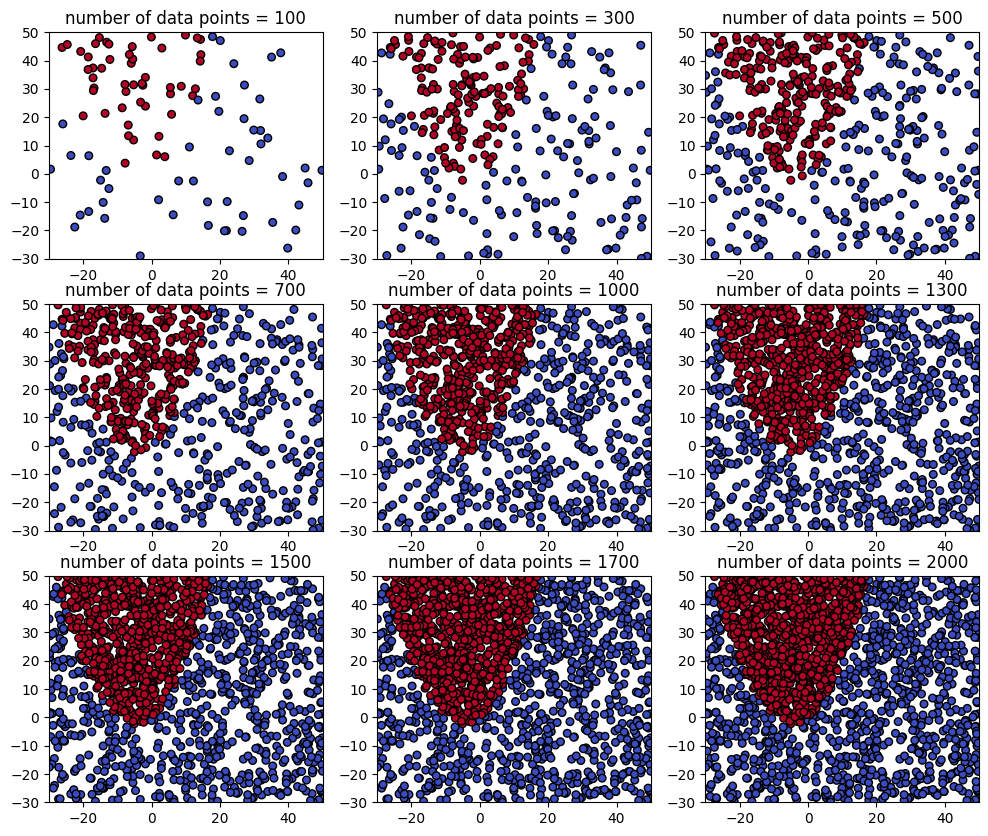

In [10]:
n_datapoints = [100, 300, 500, 700, 1000, 1300, 1500, 1700, 2000]

fig, axes = plt.subplots(3, 3, figsize=(12, 10))
for ax, n in zip(axes.ravel(), n_datapoints):
    X, y = generate_datapoints(slope=0.1, lower=low, upper=up,
                                n_datapoints=n, class_1_ratio=0.5)
    ax.scatter(X[:, 0], X[:, 1], c=y, cmap='coolwarm', s=30, edgecolors='k')
    ax.set_title(f"number of data points = {n}")
    ax.set_xlim(low, up)
    ax.set_ylim(low, up)

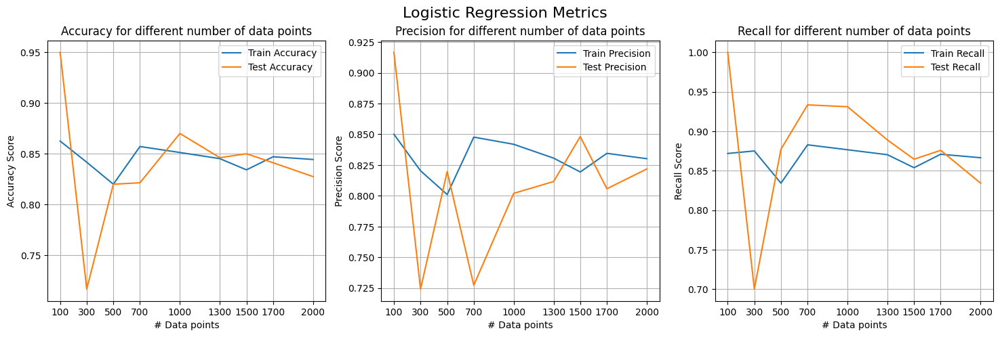

In [11]:
random.seed(100)
np.random.seed(100)

train_acc = []
test_acc = []

train_precision = []
train_recall = []
test_precision = []
test_recall = []
contour = []
c_matrix = []

for n in n_datapoints:

    X, y = generate_datapoints(slope= 0.1, lower=low, upper=up,
                                       n_datapoints=n, class_1_ratio=0.5)
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=100)

    model = LogisticRegression()
    model.fit(X_train, y_train)
    train_pred = model.predict(X_train)
    y_pred = model.predict(X_test)

    contour.append((X, y, model))
    c_matrix.append(confusion_matrix(y_test, y_pred))

    train_accuracy = accuracy_score(y_train, train_pred)
    test_accuracy = accuracy_score(y_test, y_pred)

    train_acc.append(train_accuracy)
    test_acc.append(test_accuracy)

    train_precision.append(precision_score(y_train, train_pred))
    train_recall.append(recall_score(y_train, train_pred))

    test_precision.append(precision_score(y_test, y_pred))
    test_recall.append(recall_score(y_test, y_pred))
    
fig, axs = plt.subplots(1, 3, figsize=(18, 5))
fig.suptitle("Logistic Regression Metrics", fontsize=16)

metrics = [
    ("Accuracy", train_acc, test_acc),
    ("Precision", train_precision, test_precision),
    ("Recall", train_recall, test_recall)
]

for i, (title, train_vals, test_vals) in enumerate(metrics):
    axs[i].plot(n_datapoints, train_vals, label=f'Train {title}')
    axs[i].plot(n_datapoints, test_vals, label=f'Test {title}')
    
    axs[i].set_title(f"{title} for different number of data points")
    axs[i].set_xlabel("# Data points")
    axs[i].set_ylabel(f"{title} Score")
    axs[i].set_xticks(n_datapoints)
    axs[i].set_xticklabels([str(int(n)) for n in n_datapoints])
    axs[i].grid(True)
    axs[i].legend()

plt.show()

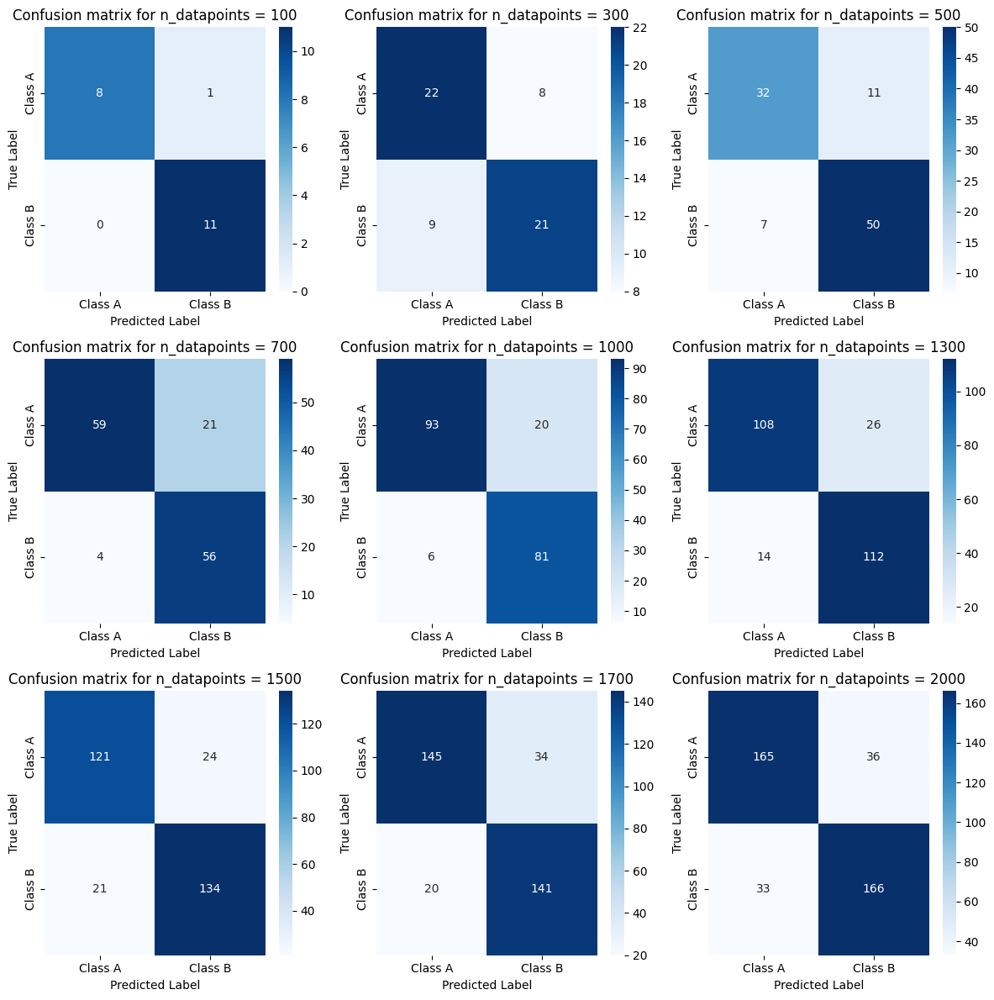

In [12]:
fig, axes = plt.subplots(3,3, figsize=(12,12) )

for ax, i in zip(axes.ravel(), range(len(c_matrix))):
    sns.heatmap(data=c_matrix[i], annot=True,fmt='d', cmap='Blues',
            xticklabels=['Class A', 'Class B'], yticklabels=['Class A', 'Class B'], ax=ax)
    ax.set_xlabel("Predicted Label")
    ax.set_ylabel("True Label")
    ax.set_title(f'Confusion matrix for n_datapoints = {n_datapoints[i]}')
plt.tight_layout()
plt.show()

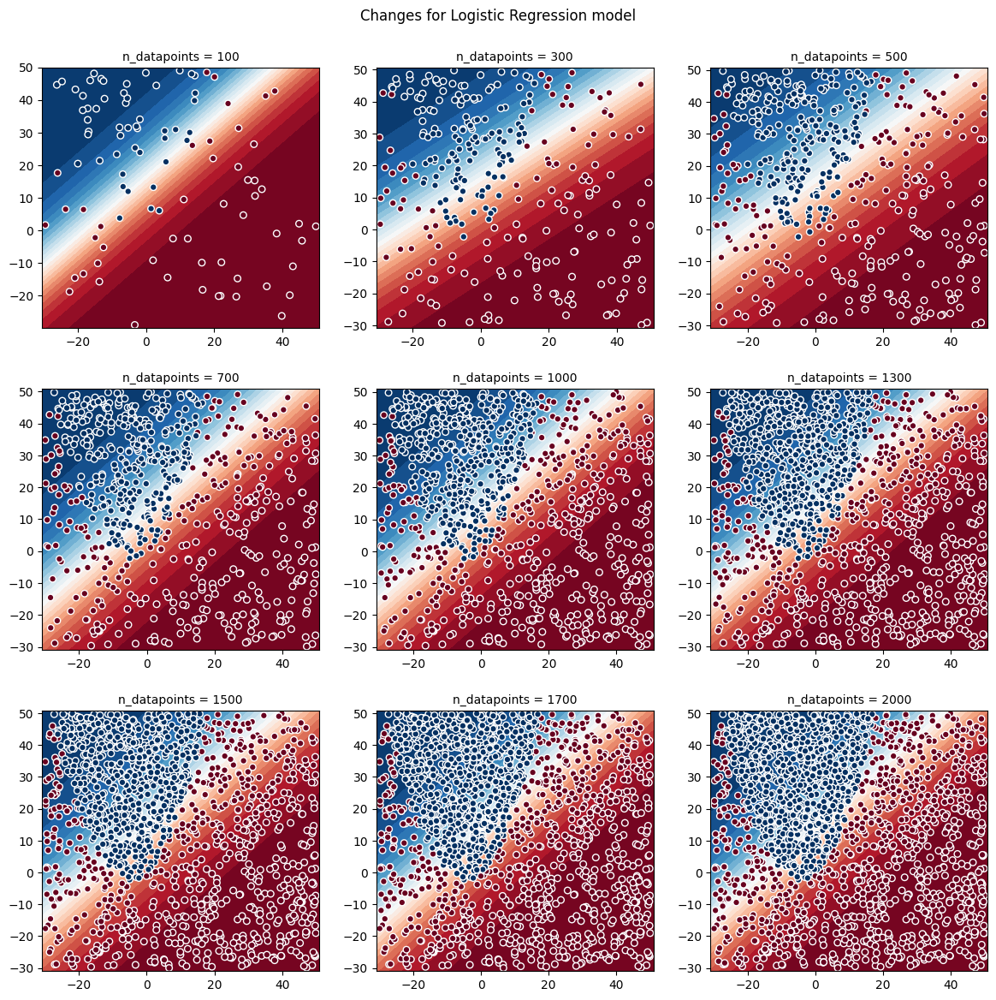

In [13]:
fig, axes = plt.subplots(3, 3, figsize=(12, 12))
fig.suptitle('Changes for Logistic Regression model')

for ax, i in zip(axes.ravel(), range(len(contour))):
    X = contour[i][0]
    y = contour[i][1]
    model = contour[i][2]
    title = f'n_datapoints = {n_datapoints[i]}'

    plot_boundary(X, y, model, title=title, ax=ax)
plt.tight_layout(pad=2.0) 
plt.show()

### 2.3 Performance of Logistic Regression model for different class ratio

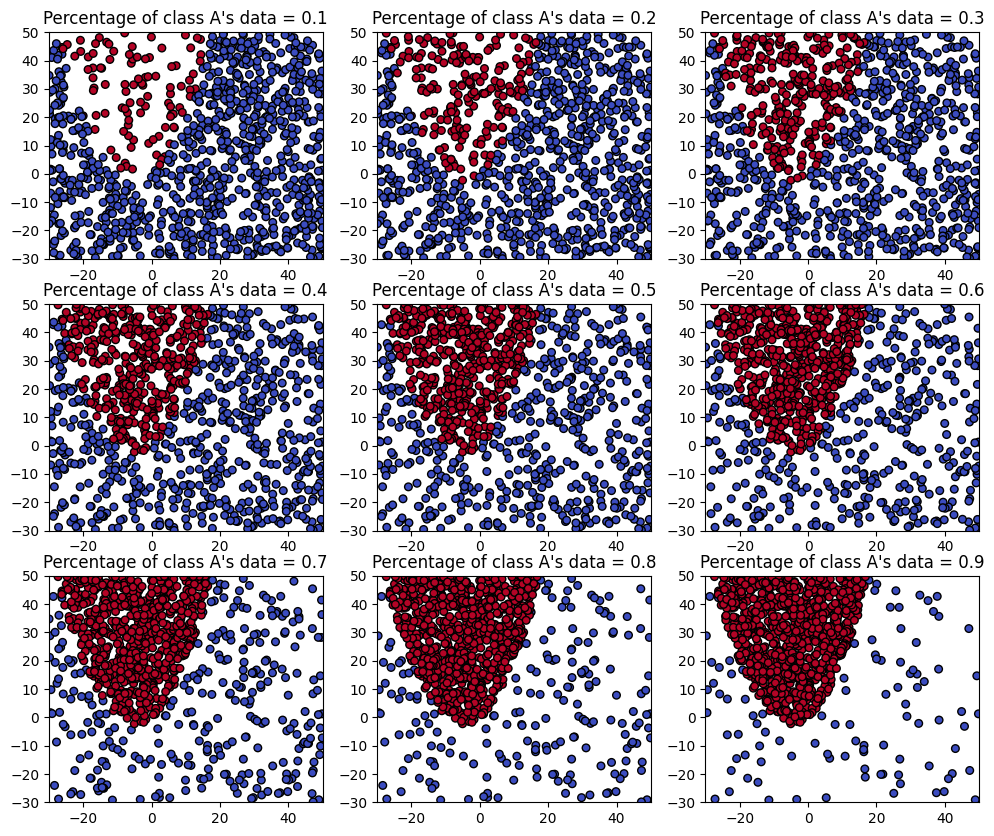

In [14]:
class_ratio = np.linspace(0.1, 0.9, 9)

fig, axes = plt.subplots(3, 3, figsize=(12, 10))
for ax, r in zip(axes.ravel(), class_ratio):
    X, y = generate_datapoints(slope=0.1, lower=low, upper=up,
                                n_datapoints=1000, class_1_ratio=r)
    ax.scatter(X[:, 0], X[:, 1], c=y, cmap='coolwarm', s=30, edgecolors='k')
    ax.set_title(f"Percentage of class A's data = {r:.1f}")
    ax.set_xlim(low, up)
    ax.set_ylim(low, up)

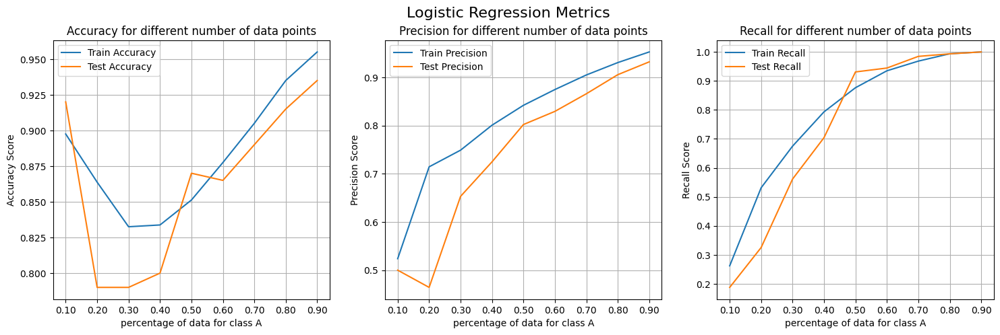

In [15]:
random.seed(100)
np.random.seed(100)

train_acc = []
test_acc = []

train_precision = []
train_recall = []
test_precision = []
test_recall = []
contour = []
c_matrix = []

for r in class_ratio:

    X, y = generate_datapoints(slope= 0.1, lower=low, upper=up,
                                       n_datapoints=1000, class_1_ratio=r)
    
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=100)

    model = LogisticRegression()
    model.fit(X_train, y_train)
    train_pred = model.predict(X_train)
    y_pred = model.predict(X_test)

    contour.append((X, y, model))
    c_matrix.append(confusion_matrix(y_test, y_pred))

    train_accuracy = accuracy_score(y_train, train_pred)
    test_accuracy = accuracy_score(y_test, y_pred)

    train_acc.append(train_accuracy)
    test_acc.append(test_accuracy)

    train_precision.append(precision_score(y_train, train_pred))
    train_recall.append(recall_score(y_train, train_pred))

    test_precision.append(precision_score(y_test, y_pred))
    test_recall.append(recall_score(y_test, y_pred))
    
fig, axs = plt.subplots(1, 3, figsize=(18, 5))
fig.suptitle("Logistic Regression Metrics", fontsize=16)

metrics = [
    ("Accuracy", train_acc, test_acc),
    ("Precision", train_precision, test_precision),
    ("Recall", train_recall, test_recall)
]

for i, (title, train_vals, test_vals) in enumerate(metrics):
    axs[i].plot(class_ratio, train_vals, label=f'Train {title}')
    axs[i].plot(class_ratio, test_vals, label=f'Test {title}')
    
    axs[i].set_title(f"{title} for different number of data points")
    axs[i].set_xlabel("percentage of data for class A")
    axs[i].set_ylabel(f"{title} Score")
    axs[i].set_xticks(class_ratio)
    axs[i].set_xticklabels([f'{r:.2f}' for r in class_ratio])
    axs[i].grid(True)
    axs[i].legend()

plt.show()

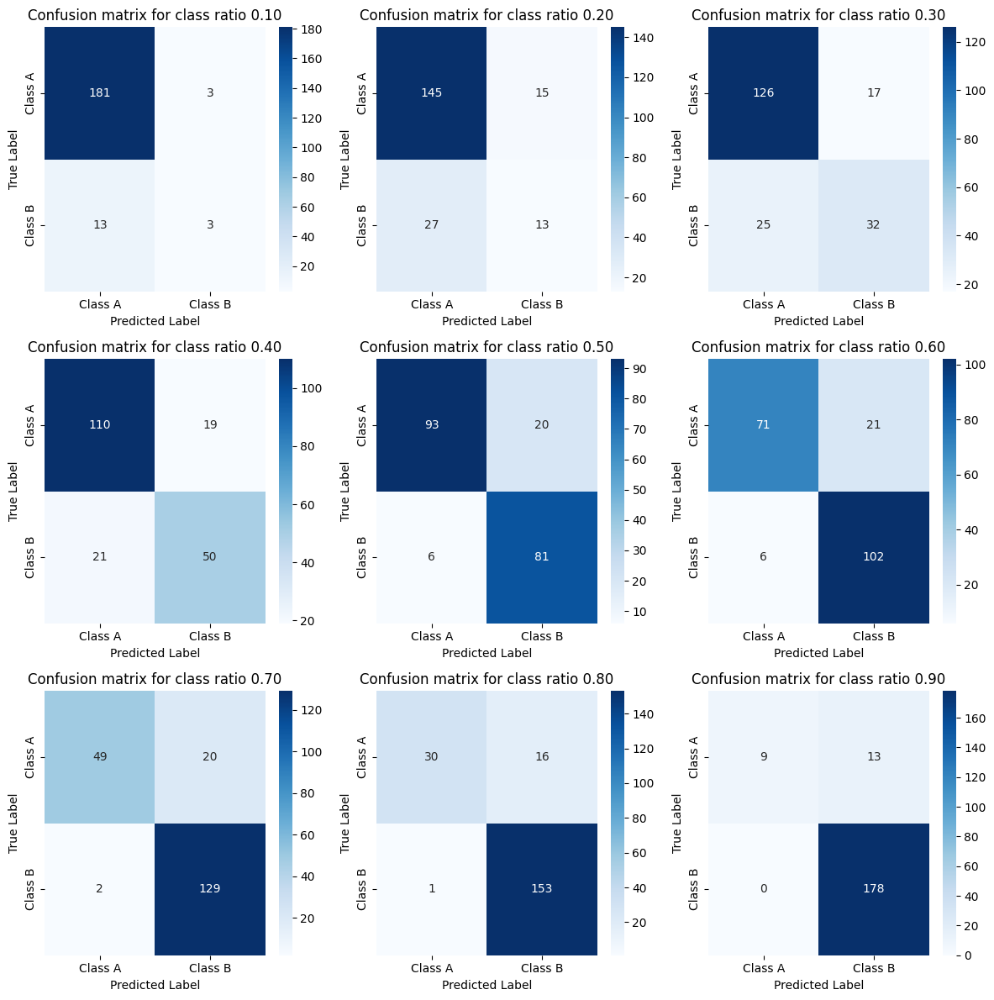

In [16]:
fig, axes = plt.subplots(3,3, figsize=(12,12) )

for ax, i in zip(axes.ravel(), range(len(c_matrix))):
    sns.heatmap(data=c_matrix[i], annot=True,fmt='d', cmap='Blues',
            xticklabels=['Class A', 'Class B'], yticklabels=['Class A', 'Class B'], ax=ax)
    ax.set_xlabel("Predicted Label")
    ax.set_ylabel("True Label")
    ax.set_title(f'Confusion matrix for class ratio {class_ratio[i]:.2f}')
plt.tight_layout()
plt.show()

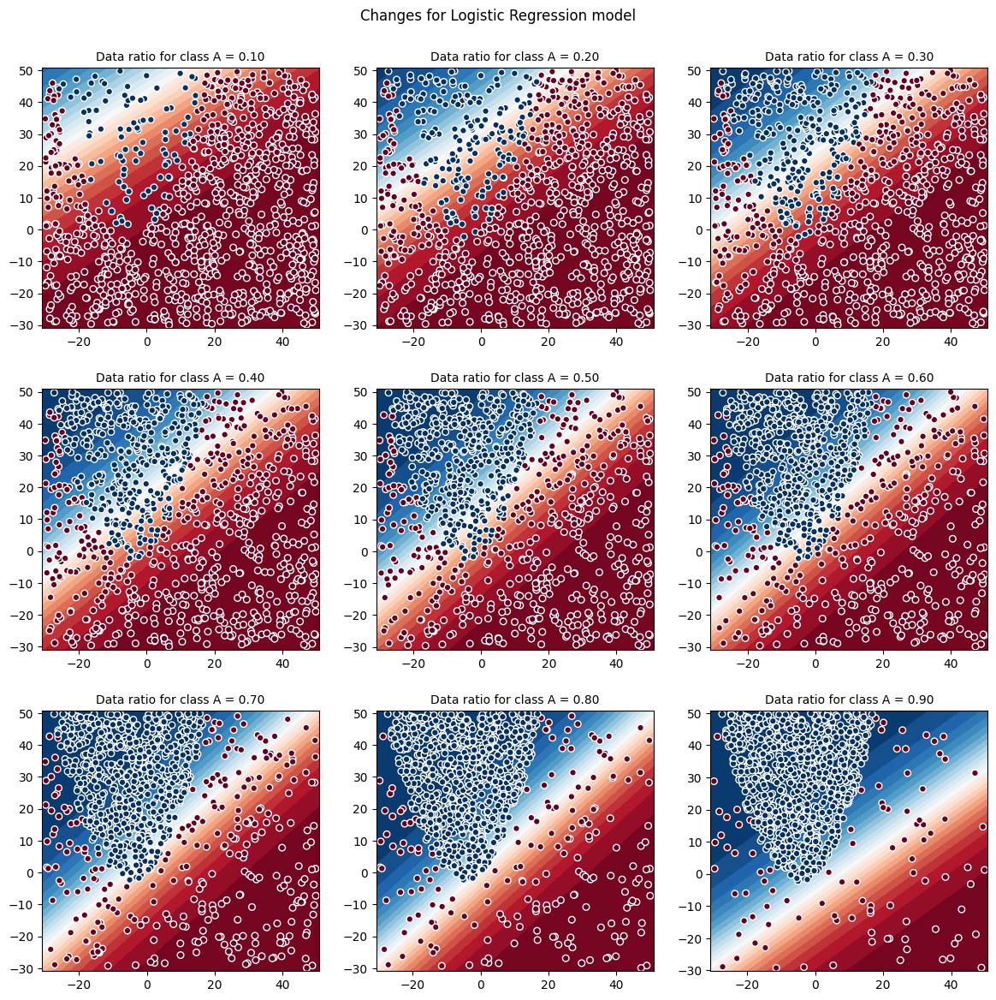

In [17]:
fig, axes = plt.subplots(3, 3, figsize=(12, 12))
fig.suptitle('Changes for Logistic Regression model')

for ax, i in zip(axes.ravel(), range(len(contour))):
    X = contour[i][0]
    y = contour[i][1]
    model = contour[i][2]
    title = f'Data ratio for class A = {class_ratio[i]:.2f}'

    plot_boundary(X, y, model, title=title, ax=ax)
plt.tight_layout(pad=2.0) 
plt.show()

## 3. Neural network

In [18]:
import torch
import torch.nn as nn
from torch.utils.data import TensorDataset, DataLoader

In [19]:

def load_data(X, y):
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=100)

    X_train_tensor = torch.tensor(X_train, dtype=torch.float32)
    y_train_tensor = torch.tensor(y_train, dtype=torch.long)

    X_test_tensor = torch.tensor(X_test, dtype=torch.float32)
    y_test_tensor = torch.tensor(y_test, dtype=torch.long)

    train_dataset = TensorDataset(X_train_tensor, y_train_tensor)
    test_dataset = TensorDataset(X_test_tensor, y_test_tensor)

    train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
    test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

    return train_loader, test_loader

In [20]:
# train_loader, test_loader = load_data(X,y)

In [21]:
class NeuralNetwork(nn.Module):
    
    def __init__(self, input_size=2, hidden_1=16, hidden_2=10, output=2):
        super().__init__()
        self.h1 = nn.Linear(input_size, hidden_1)
        self.h2 = nn.Linear(hidden_1, hidden_2)
        self.output = nn.Linear(hidden_2, output)
        self.activation = nn.ReLU()

    def forward(self, X):
        out = self.h1(X)    
        out = self.activation(out)
        out = self.h2(out)
        out = self.activation(out)
        out = self.output(out)

        return out
    
# model = NeuralNetwork(input_size, hidden_1, hidden_2, n_classes)

In [22]:
def train_model(model, n_epochs, train_loader, test_loader, learning_rate=1e-4):

    all_train_loss = []
    all_test_loss = []

    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(), lr= learning_rate) 

    for epoch in range(n_epochs):
        # print(f'Epoch {epoch+1} / {n_epochs}:')
        model.train()
        n_correct = 0
        n_samples = 0
        train_loss = []

        for i, (data, label) in enumerate(train_loader):
            # shape = (batch, n_features)
            output = model(data)
            loss = criterion(output, label)
            train_loss.append(loss.item())

            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

            train_pred = output.argmax(1)
            n_correct += (train_pred == label).sum().item()
            n_samples += label.shape[0]
        
        all_train_loss.append(np.mean(train_loss))
        train_acc = 100* n_correct/n_samples
        # print(f'Train loss = {all_train_loss[epoch]:.4f}, Train accuracy = {train_acc:.2f}%')
            
        
        with torch.no_grad():
            model.eval()
            n_correct = 0
            n_samples = 0
            test_loss = []

            for data, label in test_loader:
                output = model(data)
                loss = criterion(output, label)
                test_loss.append(loss.item())

                _, pred = torch.max(output, 1) 
                n_correct += (pred == label).sum().item()
                n_samples += label.shape[0]

            all_test_loss.append(np.mean(test_loss))
            test_acc = 100* n_correct / n_samples
            # print(f'Validation loss = {all_test_loss[epoch]:.4f}, Validation accuracy = {test_acc:.2f}%')
    
    return model, all_train_loss, all_test_loss

In [23]:
def evaluate_performance(model, dataloader):
    model.eval()
    preds = []
    lab = []

    with torch.no_grad():
        for data, label in dataloader:
            output = model(data)
            predict = output.argmax(1)
            preds.extend(predict.tolist())
            lab.extend(label.tolist())
    
    preds = np.array(preds)
    lab = np.array(lab)

    acc = 100*(preds == lab).sum() / len(lab)
    precision = precision_score(lab, preds, zero_division=0)
    recall = recall_score(lab, preds, zero_division=0)

    return acc, precision, recall

In [24]:
# trained_model, train_loss, test_loss = train_model(model, n_epochs, train_loader, test_loader) 
# train_acc, train_prec, train_rec = evaluate_performance(trained_model, train_loader)
# test_acc, test_prec, test_rec = evaluate_performance(trained_model, test_loader)

In [25]:
def plot_training(multiple_train_loss, multiple_test_loss, param_list):
    fig, axes = plt.subplots(3, 3, figsize=(15, 12))

    for idx, ax in enumerate(axes.ravel()):
        train_loss = multiple_train_loss[idx]
        test_loss = multiple_test_loss[idx]
        param_val = param_list[idx]

        ax.plot(train_loss, label='Training Loss')
        ax.plot(test_loss, label='Test Loss')
        ax.set_title(f'value = {param_val:.2f}')
        ax.set_xlabel('Epochs')
        ax.set_ylabel('Loss')
        ax.legend()
        ax.grid(True)

    plt.tight_layout()
    plt.show()

In [26]:
# plot_training(multiple_train_loss, multiple_test_loss, list)

In [27]:
def plot_nn_boundary(X, y, model, title, ax=None, show_colorbar=False):

    x_min, x_max = X[:, 0].min() - 1, X[:, 0].max() + 1
    y_min, y_max = X[:, 1].min() - 1, X[:, 1].max() + 1

    xx, yy = np.mgrid[x_min:x_max:0.05, y_min:y_max:0.05]
    grid = np.c_[xx.ravel(), yy.ravel()]
    grid_tensor = torch.FloatTensor(grid)

    model.eval()
    with torch.no_grad():
        outputs = model(grid_tensor)
        probs = torch.softmax(outputs, dim=1)[:, 1].reshape(xx.shape).numpy()

    contour = ax.contourf(xx, yy, probs, 25, cmap="RdBu", vmin=0, vmax=1)

    if show_colorbar:
        ax_c = plt.colorbar(contour, ax=ax)
        ax_c.set_label("$P(y = 1)$")

    ax.scatter(X[:, 0], X[:, 1], c=y, cmap="RdBu", edgecolor="white", s=30)
    ax.set_title(title, fontsize=10)

### 3.2 Performance of Neural Network for different values of Slope

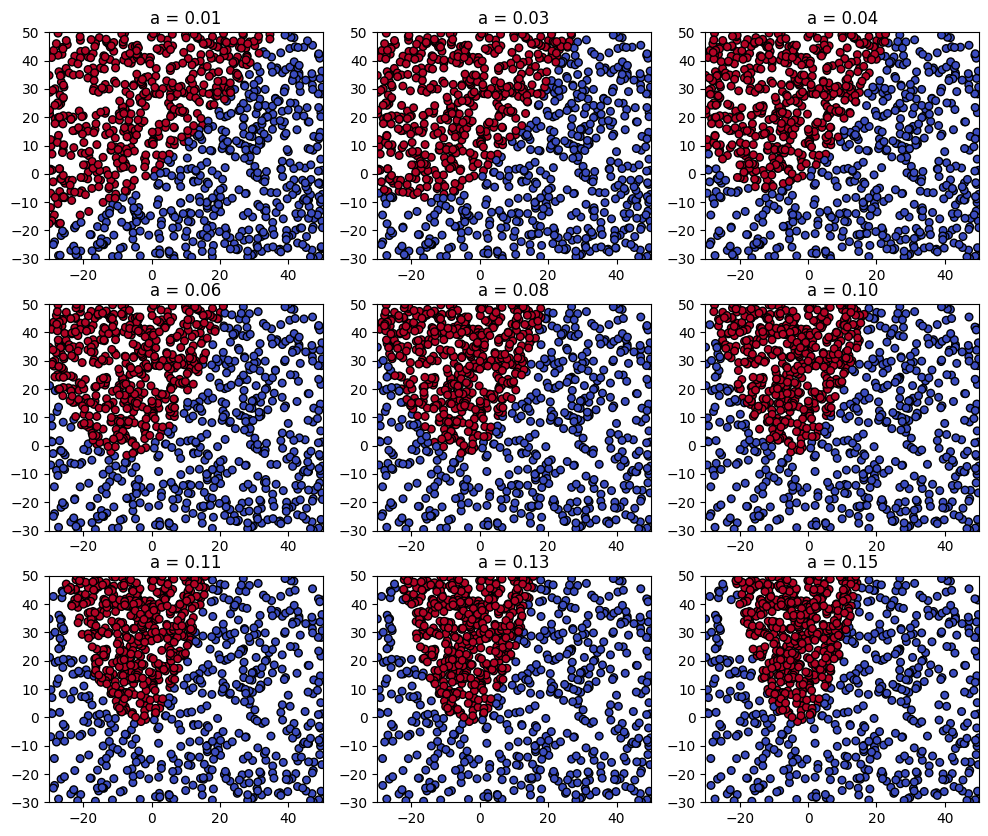

In [28]:
a_value = np.linspace(0.01, 0.15, 9)

fig, axes = plt.subplots(3, 3, figsize=(12, 10))
for ax, a in zip(axes.ravel(), a_value):
    X, y = generate_datapoints(slope=a, lower=low, upper=up,
                                n_datapoints=1000, class_1_ratio=0.5)
    ax.scatter(X[:, 0], X[:, 1], c=y, cmap='coolwarm', s=30, edgecolors='k')
    ax.set_title(f"a = {a:.2f}")
    ax.set_xlim(low, up)
    ax.set_ylim(low, up)

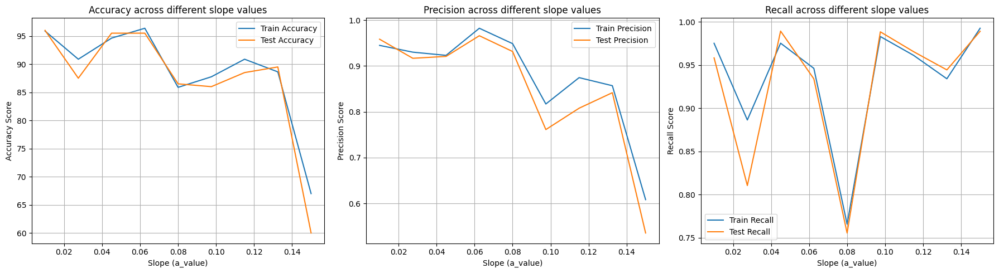

In [29]:
input_size = X.shape[1]
hidden_1 = 32
hidden_2 = 16
n_classes = 2
learning_rate = 1e-4
n_epochs = 10

multiple_train_loss = []
multiple_test_loss = []

multiple_train_acc = []
multiple_test_acc = []

multiple_train_precision = []
multiple_test_precision = []

multiple_train_recall = []
multiple_test_recall = []

contour = []

for a in a_value:
    X, y = generate_datapoints(slope=a, lower=low, upper=up,
                                n_datapoints=1000, class_1_ratio=0.5)
    
    train_loader, test_loader = load_data(X,y)

    model = NeuralNetwork(input_size, hidden_1, hidden_2, n_classes)
    trained_model, train_loss, test_loss = train_model(model, n_epochs, train_loader, test_loader) 
    train_acc, train_prec, train_rec = evaluate_performance(trained_model, train_loader)
    test_acc, test_prec, test_rec = evaluate_performance(trained_model, test_loader)
    
    multiple_train_loss.append(train_loss)
    multiple_test_loss.append(test_loss)
    multiple_train_acc.append(train_acc)
    multiple_test_acc.append(test_acc)
    multiple_train_precision.append(train_prec)
    multiple_test_precision.append(test_prec)
    multiple_train_recall.append(train_rec)
    multiple_test_recall.append(test_rec)

    contour.append((X, y, model))
    

fig, axes = plt.subplots(1, 3, figsize=(18, 5))

metrics = [
    ("Accuracy", multiple_train_acc, multiple_test_acc),
    ("Precision", multiple_train_precision, multiple_test_precision),
    ("Recall", multiple_train_recall, multiple_test_recall)
]

for i, (title, train_vals, test_vals) in enumerate(metrics):
    axes[i].plot(a_value, train_vals, label=f'Train {title}')
    axes[i].plot(a_value, test_vals, label=f'Test {title}')
    
    axes[i].set_title(f'{title} across different slope values')
    axes[i].set_xlabel('Slope (a_value)')
    axes[i].set_ylabel(f'{title} Score')
    axes[i].grid(True)
    axes[i].legend()

plt.tight_layout()
plt.show()

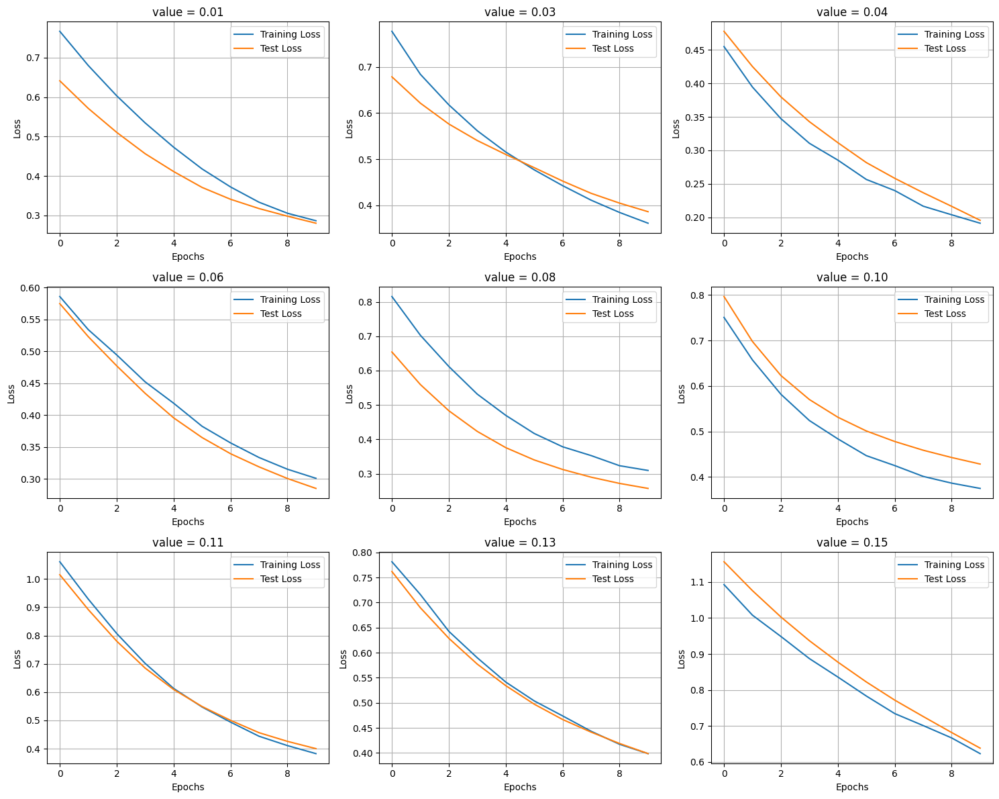

In [30]:
plot_training(multiple_train_loss, multiple_test_loss, a_value)

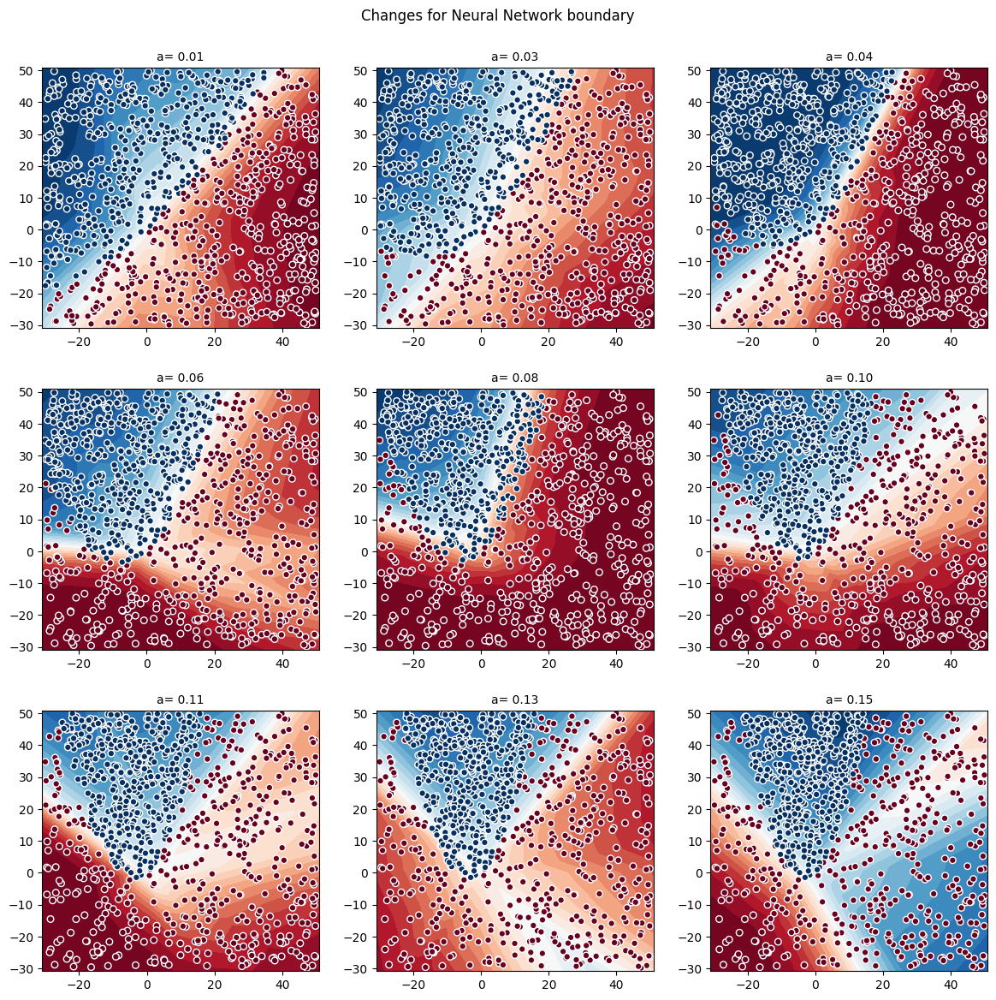

In [31]:
fig, axes = plt.subplots(3, 3, figsize=(12, 12))
fig.suptitle('Changes for Neural Network boundary')

for ax, i in zip(axes.ravel(), range(len(contour))):
    X = contour[i][0]
    y = contour[i][1]
    model = contour[i][2]
    title = f'a= {a_value[i]:.2f}'

    plot_nn_boundary(X, y, model, title=title, ax=ax)
plt.tight_layout(pad=2.0) 
plt.show()

### 3.3 Performance of Neural Network for different number of data points

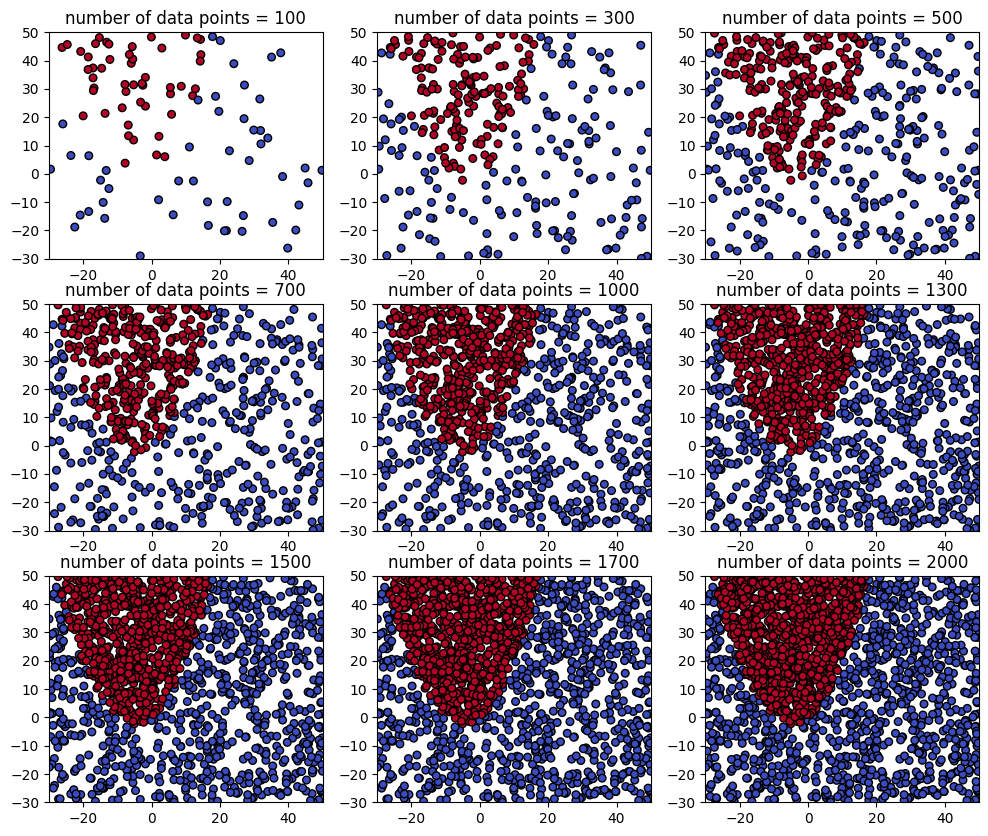

In [32]:
n_datapoints = [100, 300, 500, 700, 1000, 1300, 1500, 1700, 2000]

fig, axes = plt.subplots(3, 3, figsize=(12, 10))
for ax, n in zip(axes.ravel(), n_datapoints):
    X, y = generate_datapoints(slope=0.1, lower=low, upper=up,
                                n_datapoints=n, class_1_ratio=0.5)
    ax.scatter(X[:, 0], X[:, 1], c=y, cmap='coolwarm', s=30, edgecolors='k')
    ax.set_title(f"number of data points = {n}")
    ax.set_xlim(low, up)
    ax.set_ylim(low, up)

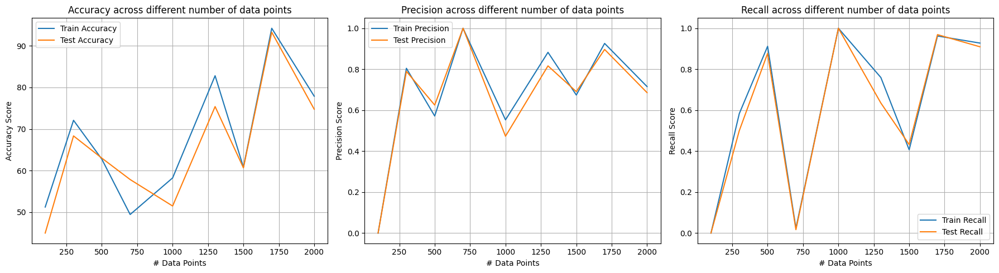

In [33]:
input_size = X.shape[1]
hidden_1 = 32
hidden_2 = 16
n_classes = 2
learning_rate = 1e-4
n_epochs = 10

multiple_train_loss = []
multiple_test_loss = []

multiple_train_acc = []
multiple_test_acc = []

multiple_train_precision = []
multiple_test_precision = []

multiple_train_recall = []
multiple_test_recall = []

contour = []

for n in n_datapoints:
    X, y = generate_datapoints(slope=0.1, lower=low, upper=up,
                                n_datapoints=n, class_1_ratio=0.5)
    
    train_loader, test_loader = load_data(X,y)

    model = NeuralNetwork(input_size, hidden_1, hidden_2, n_classes)
    trained_model, train_loss, test_loss = train_model(model, n_epochs, train_loader, test_loader) 
    train_acc, train_prec, train_rec = evaluate_performance(trained_model, train_loader)
    test_acc, test_prec, test_rec = evaluate_performance(trained_model, test_loader)
    
    multiple_train_loss.append(train_loss)
    multiple_test_loss.append(test_loss)
    multiple_train_acc.append(train_acc)
    multiple_test_acc.append(test_acc)
    multiple_train_precision.append(train_prec)
    multiple_test_precision.append(test_prec)
    multiple_train_recall.append(train_rec)
    multiple_test_recall.append(test_rec)

    contour.append((X, y, model))
    

fig, axes = plt.subplots(1, 3, figsize=(18, 5))

metrics = [
    ("Accuracy", multiple_train_acc, multiple_test_acc),
    ("Precision", multiple_train_precision, multiple_test_precision),
    ("Recall", multiple_train_recall, multiple_test_recall)
]

for i, (title, train_vals, test_vals) in enumerate(metrics):
    axes[i].plot(n_datapoints, train_vals, label=f'Train {title}')
    axes[i].plot(n_datapoints, test_vals, label=f'Test {title}')
    
    axes[i].set_title(f'{title} across different number of data points')
    axes[i].set_xlabel('# Data Points')
    axes[i].set_ylabel(f'{title} Score')
    axes[i].grid(True)
    axes[i].legend()

plt.tight_layout()
plt.show()

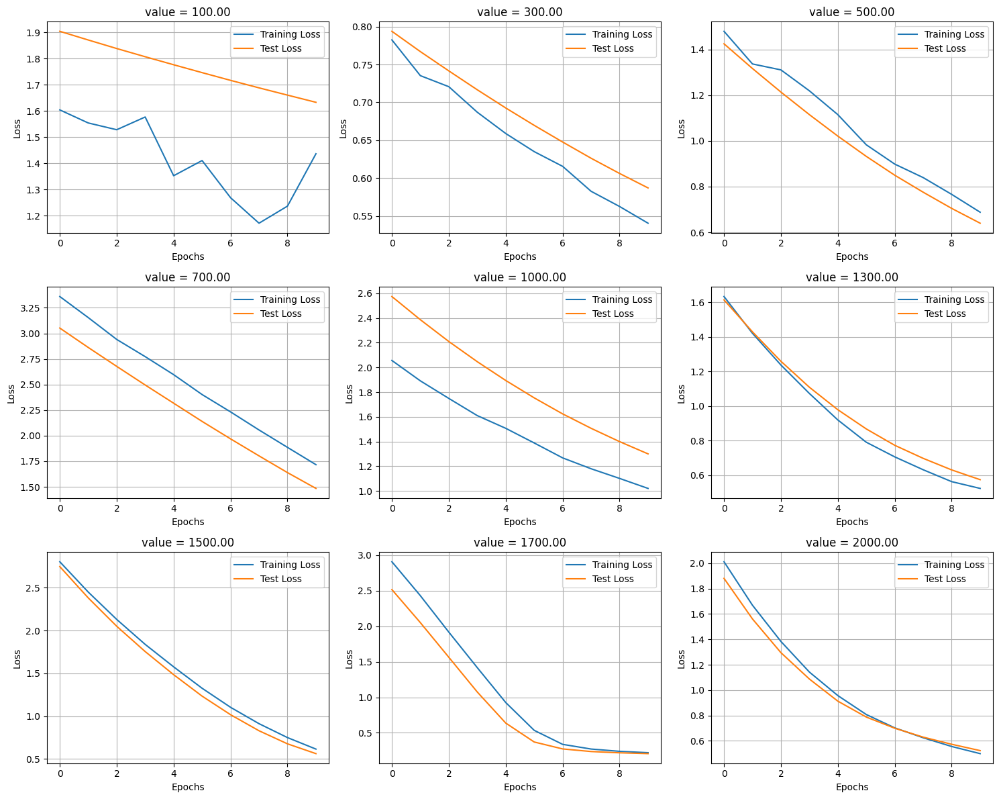

In [34]:
plot_training(multiple_train_loss, multiple_test_loss, n_datapoints)

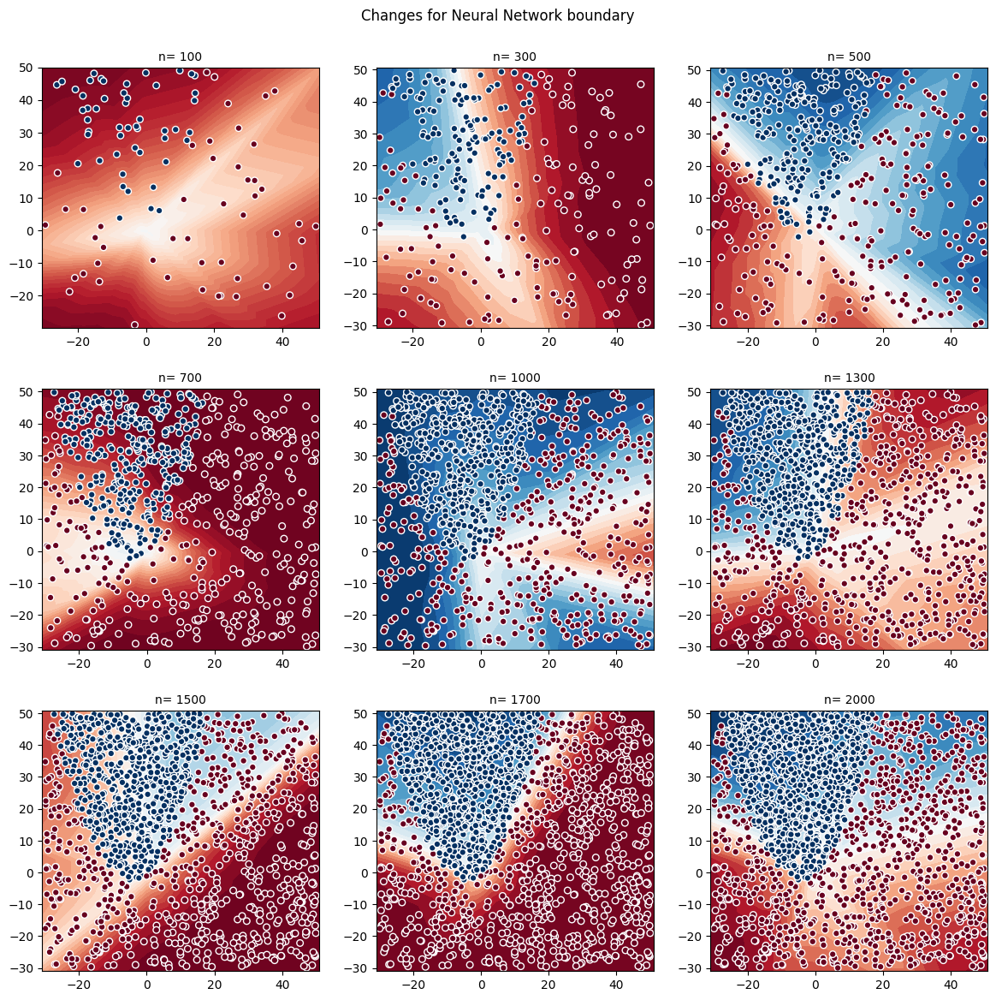

In [35]:
fig, axes = plt.subplots(3, 3, figsize=(12, 12))
fig.suptitle('Changes for Neural Network boundary')

for ax, i in zip(axes.ravel(), range(len(contour))):
    X = contour[i][0]
    y = contour[i][1]
    model = contour[i][2]
    title = f'n= {n_datapoints[i]}'

    plot_nn_boundary(X, y, model, title=title, ax=ax)
plt.tight_layout(pad=2.0) 
plt.show()

### 3.4 Performance of Neural Network for different number of class split

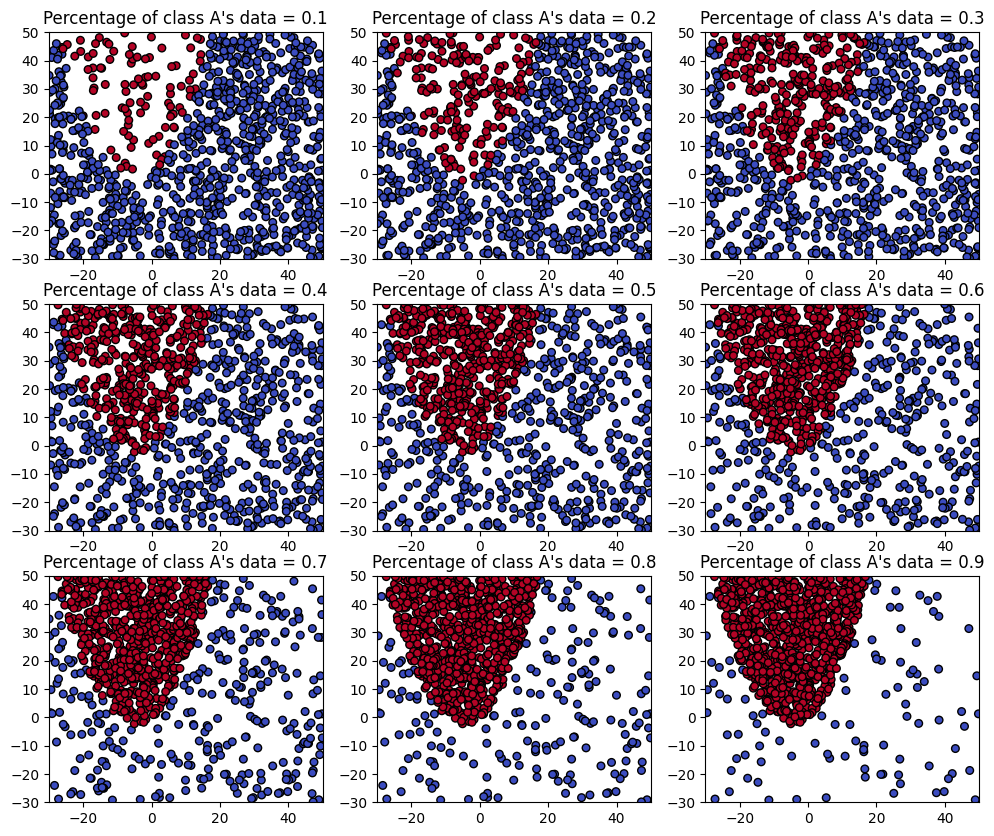

In [36]:
class_ratio = np.linspace(0.1, 0.9, 9)

fig, axes = plt.subplots(3, 3, figsize=(12, 10))
for ax, r in zip(axes.ravel(), class_ratio):
    X, y = generate_datapoints(slope=0.1, lower=low, upper=up,
                                n_datapoints=1000, class_1_ratio=r)
    ax.scatter(X[:, 0], X[:, 1], c=y, cmap='coolwarm', s=30, edgecolors='k')
    ax.set_title(f"Percentage of class A's data = {r:.1f}")
    ax.set_xlim(low, up)
    ax.set_ylim(low, up)

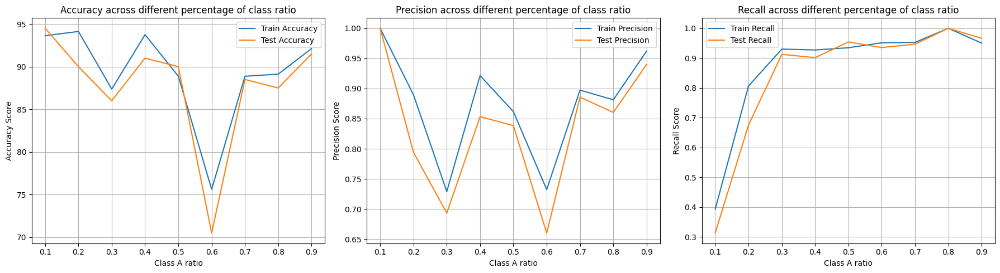

In [37]:
input_size = X.shape[1]
hidden_1 = 32
hidden_2 = 16
n_classes = 2
learning_rate = 1e-4
n_epochs = 10

multiple_train_loss = []
multiple_test_loss = []

multiple_train_acc = []
multiple_test_acc = []

multiple_train_precision = []
multiple_test_precision = []

multiple_train_recall = []
multiple_test_recall = []

contour = []

for r in class_ratio:
    X, y = generate_datapoints(slope=0.1, lower=low, upper=up,
                                n_datapoints=1000, class_1_ratio=r)
    
    train_loader, test_loader = load_data(X,y)

    model = NeuralNetwork(input_size, hidden_1, hidden_2, n_classes)
    trained_model, train_loss, test_loss = train_model(model, n_epochs, train_loader, test_loader) 
    train_acc, train_prec, train_rec = evaluate_performance(trained_model, train_loader)
    test_acc, test_prec, test_rec = evaluate_performance(trained_model, test_loader)
    
    multiple_train_loss.append(train_loss)
    multiple_test_loss.append(test_loss)
    multiple_train_acc.append(train_acc)
    multiple_test_acc.append(test_acc)
    multiple_train_precision.append(train_prec)
    multiple_test_precision.append(test_prec)
    multiple_train_recall.append(train_rec)
    multiple_test_recall.append(test_rec)

    contour.append((X, y, model))
    

fig, axes = plt.subplots(1, 3, figsize=(18, 5))

metrics = [
    ("Accuracy", multiple_train_acc, multiple_test_acc),
    ("Precision", multiple_train_precision, multiple_test_precision),
    ("Recall", multiple_train_recall, multiple_test_recall)
]

for i, (title, train_vals, test_vals) in enumerate(metrics):
    axes[i].plot(class_ratio, train_vals, label=f'Train {title}')
    axes[i].plot(class_ratio, test_vals, label=f'Test {title}')
    
    axes[i].set_title(f'{title} across different percentage of class ratio')
    axes[i].set_xlabel('Class A ratio')
    axes[i].set_ylabel(f'{title} Score')
    axes[i].grid(True)
    axes[i].legend()

plt.tight_layout()
plt.show()

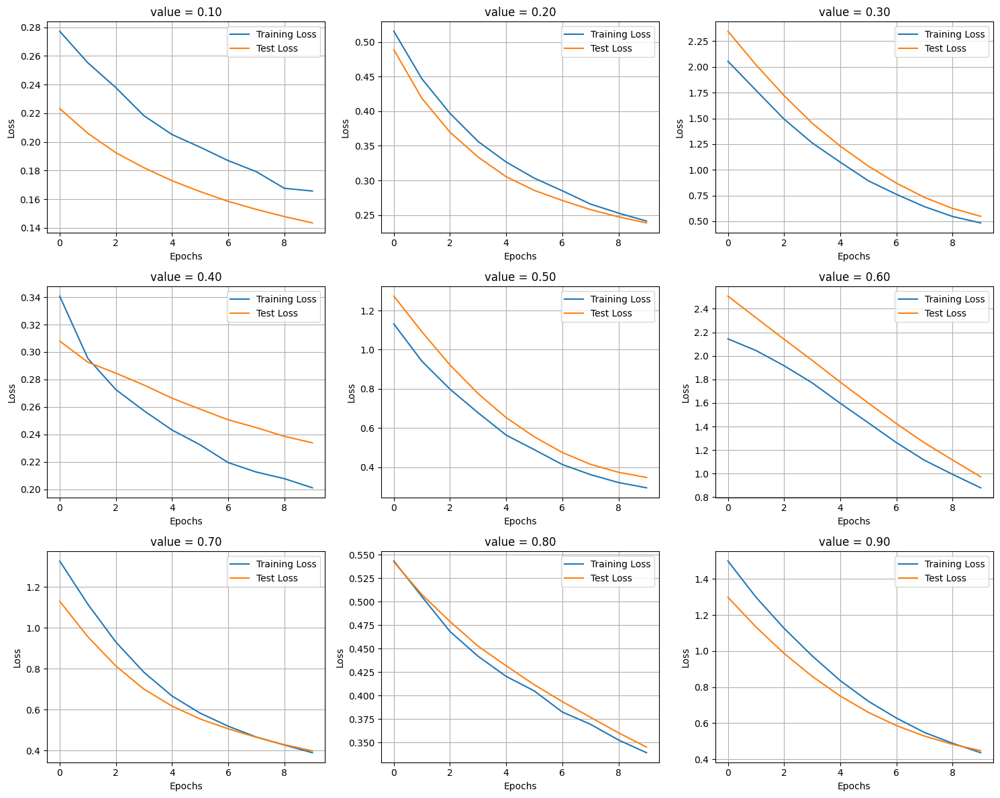

In [38]:
plot_training(multiple_train_loss, multiple_test_loss, class_ratio)

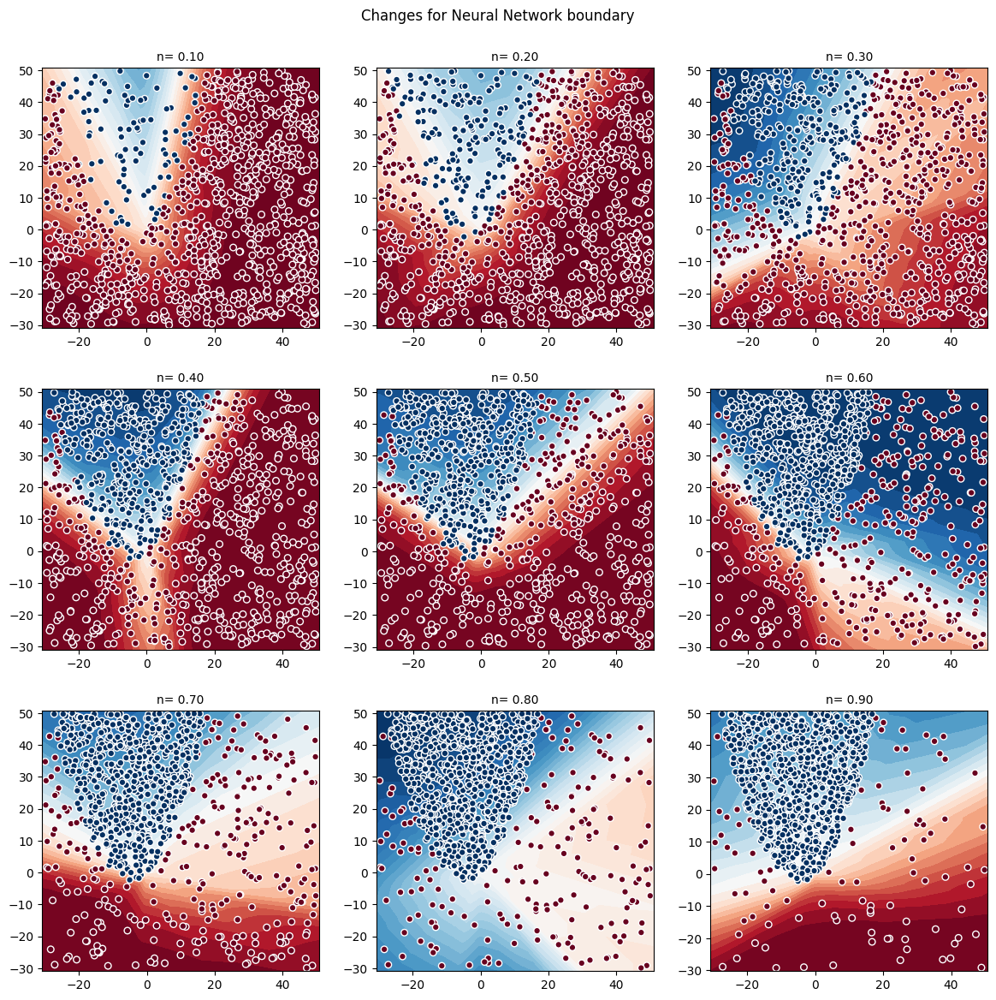

In [39]:
fig, axes = plt.subplots(3, 3, figsize=(12, 12))
fig.suptitle('Changes for Neural Network boundary')

for ax, i in zip(axes.ravel(), range(len(contour))):
    X = contour[i][0]
    y = contour[i][1]
    model = contour[i][2]
    title = f'n= {class_ratio[i]:.2f}'

    plot_nn_boundary(X, y, model, title=title, ax=ax)
plt.tight_layout(pad=2.0) 
plt.show()

### 3.5 Performance of Neural Network for different network size

#### 3.5a Neural Network with 1 hidden layer

In [40]:
class NeuralNetworkSingleLayer(nn.Module):
    
    def __init__(self, input_size=2, hidden=8, output=2):
        super().__init__()
        self.h = nn.Linear(input_size, hidden)
        self.output = nn.Linear(hidden, output)
        self.activation = nn.ReLU()

    def forward(self, X):
        out = self.h(X)    
        out = self.activation(out)
        out = self.output(out)

        return out

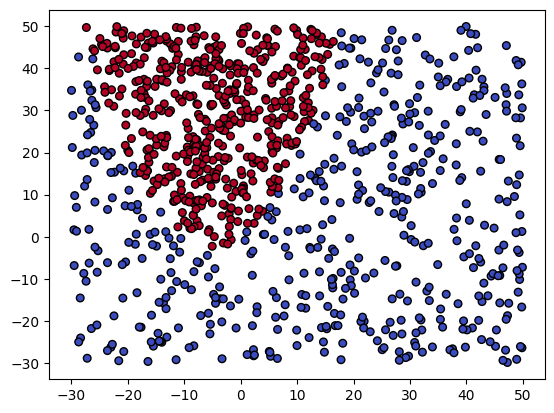

In [41]:
X, y = generate_datapoints(0.1, low, up, n_datapoints=1000, class_1_ratio = 0.5)

plt.scatter(X[:,0], X[:,1], c=y, cmap="coolwarm", edgecolor="k", s=30)
plt.show()

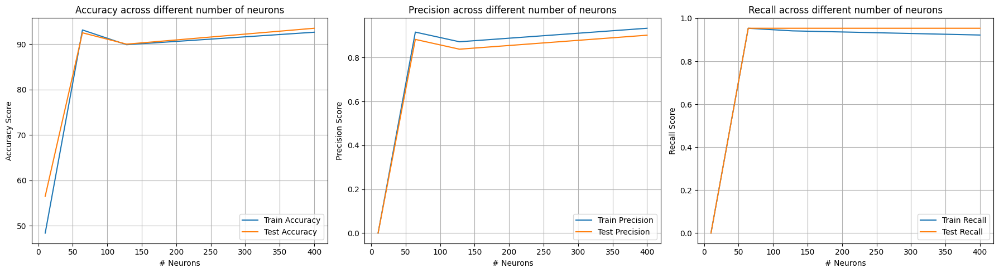

In [42]:
hidden_neuron = [10, 64, 128, 400]

multiple_train_loss = []
multiple_test_loss = []

multiple_train_acc = []
multiple_test_acc = []

multiple_train_precision = []
multiple_test_precision = []

multiple_train_recall = []
multiple_test_recall = []

contour = []

for neuron in hidden_neuron:
    input_size = X.shape[1]
    hidden = neuron
    n_classes = 2
    learning_rate = 1e-4
    n_epochs = 10

    train_loader, test_loader = load_data(X,y)

    model = NeuralNetworkSingleLayer(input_size, hidden, n_classes)
    trained_model, train_loss, test_loss = train_model(model, n_epochs, train_loader, test_loader) 
    train_acc, train_prec, train_rec = evaluate_performance(trained_model, train_loader)
    test_acc, test_prec, test_rec = evaluate_performance(trained_model, test_loader)
    
    multiple_train_loss.append(train_loss)
    multiple_test_loss.append(test_loss)
    multiple_train_acc.append(train_acc)
    multiple_test_acc.append(test_acc)
    multiple_train_precision.append(train_prec)
    multiple_test_precision.append(test_prec)
    multiple_train_recall.append(train_rec)
    multiple_test_recall.append(test_rec)

    contour.append((X, y, model))
    

fig, axes = plt.subplots(1, 3, figsize=(18, 5))

metrics = [
    ("Accuracy", multiple_train_acc, multiple_test_acc),
    ("Precision", multiple_train_precision, multiple_test_precision),
    ("Recall", multiple_train_recall, multiple_test_recall)
]

for i, (title, train_vals, test_vals) in enumerate(metrics):
    axes[i].plot(hidden_neuron, train_vals, label=f'Train {title}')
    axes[i].plot(hidden_neuron, test_vals, label=f'Test {title}')
    
    axes[i].set_title(f'{title} across different number of neurons')
    axes[i].set_xlabel('# Neurons')
    axes[i].set_ylabel(f'{title} Score')
    axes[i].grid(True)
    axes[i].legend()

plt.tight_layout()
plt.show() 

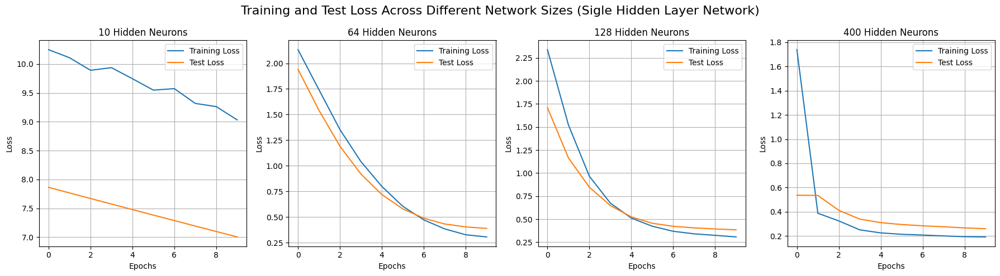

In [43]:
fig, axes = plt.subplots(1, 4, figsize=(18, 5))

for idx, ax in enumerate(axes):
    train_loss = multiple_train_loss[idx]
    test_loss = multiple_test_loss[idx]
    neuron_count = hidden_neuron[idx]
    
    ax.plot(train_loss, label='Training Loss')
    ax.plot(test_loss, label='Test Loss')
    
    ax.set_title(f'{neuron_count} Hidden Neurons')
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.legend()
    ax.grid(True)

plt.suptitle('Training and Test Loss Across Different Network Sizes (Sigle Hidden Layer Network)', fontsize=16)
plt.tight_layout()
plt.show()

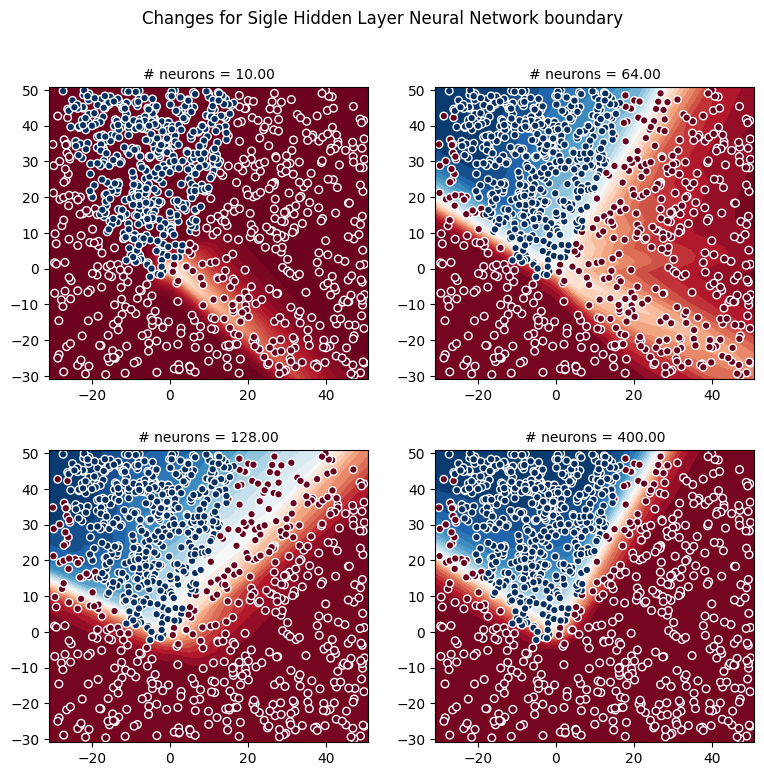

In [44]:
fig, axes = plt.subplots(2, 2, figsize=(8,8))
fig.suptitle('Changes for Sigle Hidden Layer Neural Network boundary')

for ax, i in zip(axes.ravel(), range(len(contour))):
    X = contour[i][0]
    y = contour[i][1]
    model = contour[i][2]
    title = f'# neurons = {hidden_neuron[i]:.2f}'

    plot_nn_boundary(X, y, model, title=title, ax=ax)
plt.tight_layout(pad=2.0) 
plt.show()

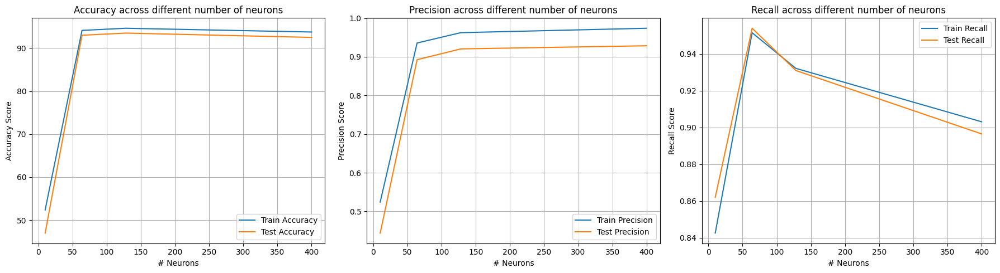

In [45]:
hidden_neuron = [10, 64, 128, 400]

multiple_train_loss = []
multiple_test_loss = []

multiple_train_acc = []
multiple_test_acc = []

multiple_train_precision = []
multiple_test_precision = []

multiple_train_recall = []
multiple_test_recall = []

contour = []

for neuron in hidden_neuron:
    input_size = X.shape[1]
    hidden_1 = neuron
    hidden_2 = neuron
    n_classes = 2
    learning_rate = 1e-4
    n_epochs = 10

    train_loader, test_loader = load_data(X,y)

    model = NeuralNetwork(input_size, hidden_1, hidden_2, n_classes)
    trained_model, train_loss, test_loss = train_model(model, n_epochs, train_loader, test_loader) 
    train_acc, train_prec, train_rec = evaluate_performance(trained_model, train_loader)
    test_acc, test_prec, test_rec = evaluate_performance(trained_model, test_loader)
    
    multiple_train_loss.append(train_loss)
    multiple_test_loss.append(test_loss)
    multiple_train_acc.append(train_acc)
    multiple_test_acc.append(test_acc)
    multiple_train_precision.append(train_prec)
    multiple_test_precision.append(test_prec)
    multiple_train_recall.append(train_rec)
    multiple_test_recall.append(test_rec)

    contour.append((X, y, model))
    

fig, axes = plt.subplots(1, 3, figsize=(18, 5))

metrics = [
    ("Accuracy", multiple_train_acc, multiple_test_acc),
    ("Precision", multiple_train_precision, multiple_test_precision),
    ("Recall", multiple_train_recall, multiple_test_recall)
]

for i, (title, train_vals, test_vals) in enumerate(metrics):
    axes[i].plot(hidden_neuron, train_vals, label=f'Train {title}')
    axes[i].plot(hidden_neuron, test_vals, label=f'Test {title}')
    
    axes[i].set_title(f'{title} across different number of neurons')
    axes[i].set_xlabel('# Neurons')
    axes[i].set_ylabel(f'{title} Score')
    axes[i].grid(True)
    axes[i].legend()

plt.tight_layout()
plt.show() 

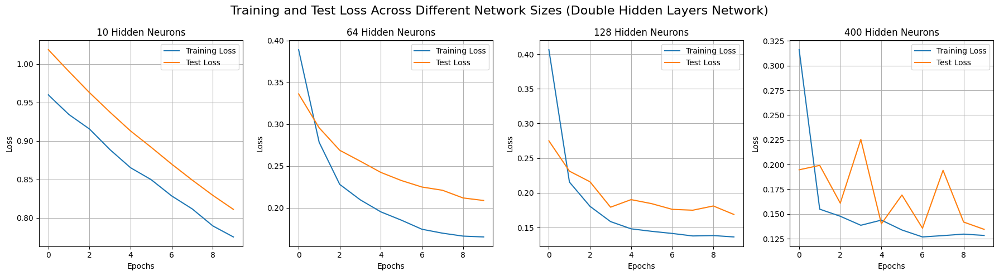

In [46]:
fig, axes = plt.subplots(1, 4, figsize=(18, 5))

for idx, ax in enumerate(axes):
    train_loss = multiple_train_loss[idx]
    test_loss = multiple_test_loss[idx]
    neuron_count = hidden_neuron[idx]
    
    ax.plot(train_loss, label='Training Loss')
    ax.plot(test_loss, label='Test Loss')
    
    ax.set_title(f'{neuron_count} Hidden Neurons')
    ax.set_xlabel('Epochs')
    ax.set_ylabel('Loss')
    ax.legend()
    ax.grid(True)

plt.suptitle('Training and Test Loss Across Different Network Sizes (Double Hidden Layers Network)', fontsize=16)
plt.tight_layout()
plt.show()

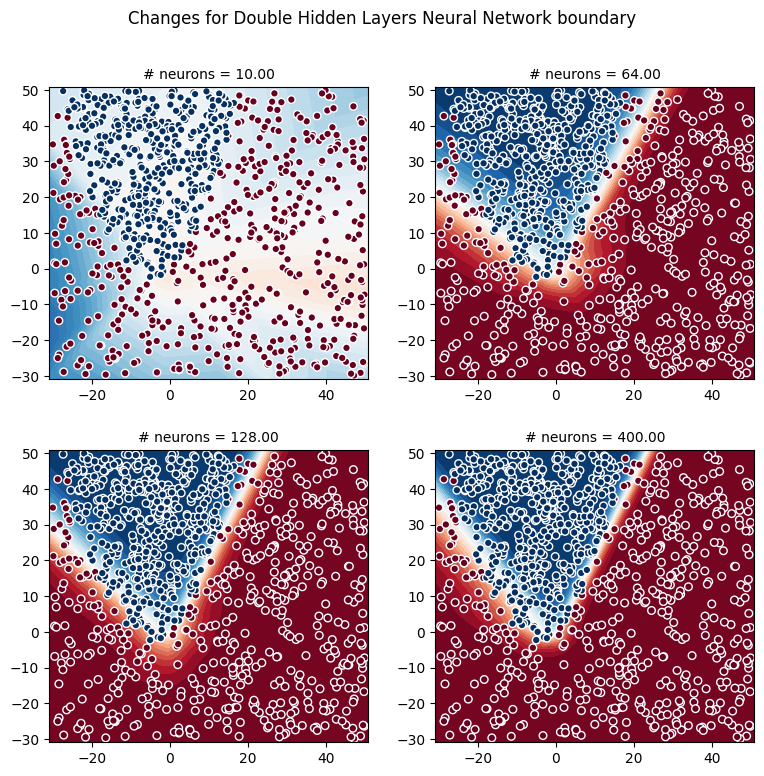

In [47]:
fig, axes = plt.subplots(2, 2, figsize=(8,8))
fig.suptitle('Changes for Double Hidden Layers Neural Network boundary')

for ax, i in zip(axes.ravel(), range(len(contour))):
    X = contour[i][0]
    y = contour[i][1]
    model = contour[i][2]
    title = f'# neurons = {hidden_neuron[i]:.2f}'

    plot_nn_boundary(X, y, model, title=title, ax=ax)
plt.tight_layout(pad=2.0) 
plt.show()